In [1]:
import datetime as dt

from IPython.display import Image

import numpy as np
import pandas as pd
import matplotlib as mpl 
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import xarray as xr
import cartopy
import cartopy.crs as ccrs
import matplotlib.cm as cmx
import matplotlib.ticker as mticker
import cartopy.feature as cfeature
import scipy.io as sio
import gsw
import seaborn

def datetime2doy(datetime):
    doys = np.zeros_like(np.array(datetime))
    for k in range(len(doys)):
        y0=datetime[k].year
        datetime_startofyear=dt.datetime(year=y0, month=1, day=1)
        doys[k] = (datetime[k] - datetime_startofyear)/dt.timedelta(days=1)
    return doys
    
def hrssince2datetime(hrs,epoch):
    return epoch + dt.timedelta(hours=1) * hrs


import matplotlib.pyplot as plt
plt.close("all")

# for captioning and labelling output figures inside the notebook when published to latex
def latexImage(fname,label,caption,width=0.7):
    display(Image(filename=fname,width=600),
            metadata={"ipub":{
             "figure":{
             "caption":caption,
             "label":label,
             "width":width}}})
    
# Example of making your own norm.  Also see matplotlib.colors.
# From Joe Kington: This one gives two different linear ramps:    
class MidpointNormalize(colors.Normalize):
    def __init__(self, vmin=None, vmax=None, midpoint=None, clip=False):
        self.midpoint = midpoint
        colors.Normalize.__init__(self, vmin, vmax, clip)

    def __call__(self, value, clip=None):
        # I'm ignoring masked values and all kinds of edge cases to make a
        # simple example...
        x, y = [self.vmin, self.midpoint, self.vmax], [0, 0.5, 1]
        return np.ma.masked_array(np.interp(value, x, y))
    
import re

def tex_escape(text):
    """
        :param text: a plain text message
        :return: the message escaped to appear correctly in LaTeX
    """
    conv = {
        '&': r'\&',
        '%': r'\%',
        '$': r'\$',
        '#': r'\#',
        '_': r'\_',
        '{': r'\{',
        '}': r'\}',
        '~': r'\textasciitilde{}',
        '^': r'\^{}',
        '\\': r'\textbackslash{}',
        '<': r'\textless{}',
        '>': r'\textgreater{}',
    }
    regex = re.compile('|'.join(re.escape(str(key)) for key in sorted(conv.keys(), key = lambda item: - len(item))))
    return regex.sub(lambda match: conv[match.group()], text)



In [2]:
# returns: axes for cartopy plot
# and latlon2xy convenience function to convert latlon to chosen projection
def map_blueprint (plotbathymetry=False,printmap=True,plotstations=False, 
                   fig=False,plotxlabels=True,plotylabels=True,
                   icecampmarker = True,
                   icecampmarkercolor='yellow',
                  label=0):
    if not printmap:
        plotbathymetry=False
        plotstations=False
    
    import matplotlib as mpl
    import cartopy.crs as ccrs
    import matplotlib.pyplot as plt
    import matplotlib.ticker as mticker
    import numpy as np
    import cartopy.feature as cfeature

    proj = ccrs.LambertConformal(central_longitude=-60, central_latitude=70,standard_parallels=(65,75))

    if fig==False:
        fig=plt.subplots()[0]
        ax = plt.axes(projection = proj)
    else:
        ax = fig.add_axes([.1,.1,.8,.8],projection = proj,label='axes{:d}'.format(label))
    hc=ax.coastlines(resolution='50m')

    MapExtent = [-66,-53,67,71.5]
    ax.set_extent(MapExtent, ccrs.PlateCarree())
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=False,
                      linewidth=1, color='gray', alpha=0.5, linestyle='--')

    gl.xlocator = mticker.FixedLocator([-75,-70,-65,-60,-55,-50,-45])
    gl.ylocator = mticker.FixedLocator([60,64,67,68,69,70,71,72,76])

    if plotxlabels:
        # LONGITUDE LABELS
        y0,_ = ax.get_ylim()
        for lon in [-65,-60,-55]:
            x0,_ = proj.transform_point(lon,MapExtent[2]-1,src_crs = ccrs.PlateCarree())
            plt.text(x0,y0-1e4,'{:2d}$^\circ$W'.format(-lon),horizontalalignment = 'center',verticalalignment='top')

    if plotylabels:
        # LATITUDE LABELS
        x0,_ = ax.get_xlim()
        someLons = np.arange(-90,-40,1)
        for lat in [68,69,70,71]:
            # interpolate latitude circle to map boundary
            xyzArray = proj.transform_points(ccrs.PlateCarree(),
                                        someLons,lat*np.ones_like(someLons))
            x = xyzArray[:,0]
            y = xyzArray[:,1]
            y0 = np.interp(x0,x,y)
            plt.text(x0-1e4,y0,'{:2d}$^\circ$N'.format(lat),horizontalalignment = 'right',verticalalignment='center')

    def latlon2xy(lon,lat):
        xyz = proj.transform_points(ccrs.PlateCarree(),lon,lat).squeeze()
        x,y,_ = np.split(xyz,3,axis=len(xyz.shape)-1)
        x[np.isinf(x)]=np.nan
        y[np.isinf(y)]=np.nan
        return x.squeeze(),y.squeeze()

    # ICE CAMP
    if icecampmarker:
        xIceCamp,yIceCamp = latlon2xy(np.array([-63.78953333]),np.array([67.47973333]))
        ax.plot(xIceCamp,yIceCamp,'*',markeredgecolor='k',markerfacecolor=icecampmarkercolor,markersize=15)
    
    # GE Stations
    if plotstations:
        ctd=pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data.pandas')
        ax.plot(*latlon2xy(np.array(ctd['Longitude']),np.array(ctd['Latitude'])),
                'o',markeredgecolor='k',markerfacecolor='white',markersize=6)

    if plotbathymetry:
        import scipy.io as sio
        top = sio.loadmat('/Users/doppler/database/IBCAO/IBCAO_1min_bathy.mat')
        lonMap,latMap=np.meshgrid(top['x'],top['y'])
        zMap=-top['IBCAO_1min']
        xMap,yMap = latlon2xy(lonMap,latMap)
        ax.contour(xMap,yMap,zMap,levels=[250,500],colors='gray',linewidths=1.5)
    
    if not printmap: plt.close(fig)
    
    return ax,latlon2xy,fig

_,latlon2xy,_=map_blueprint(printmap=False)

# Introduction

This document provides supplementary material to our study on Baffin Bay hydrography and the environmental constraints during a phytoplankton bloom at the retreating ice edge. It provides more detail on some of the methods, but mostly shows more variables that may help the interested reader in getting a better overview over the immense dataset the Green Edge campaign has produced. All data are accessible at the Green Edge database (\url{http://www.obs-vlfr.fr/proof/php/GREENEDGE/greenedge.php}).

## Acknowledgments

This document was created as a [Jupyter Lab](https://github.com/jupyterlab/jupyterlab) notebook and exported to pdf partly using Chris Sewell's [ipypublish](https://github.com/chrisjsewell/ipypublish) template.

## More overview maps

The following true color images are meant to provide more context for the campaign, especially with regards to floe sizes and general impressions of the ice cover that are hard to capture in sea ice concentration charts. Surface chlorophyll-a and sea temperature show the phytoplankton growth and warming trailing behind the retreating ice edge.

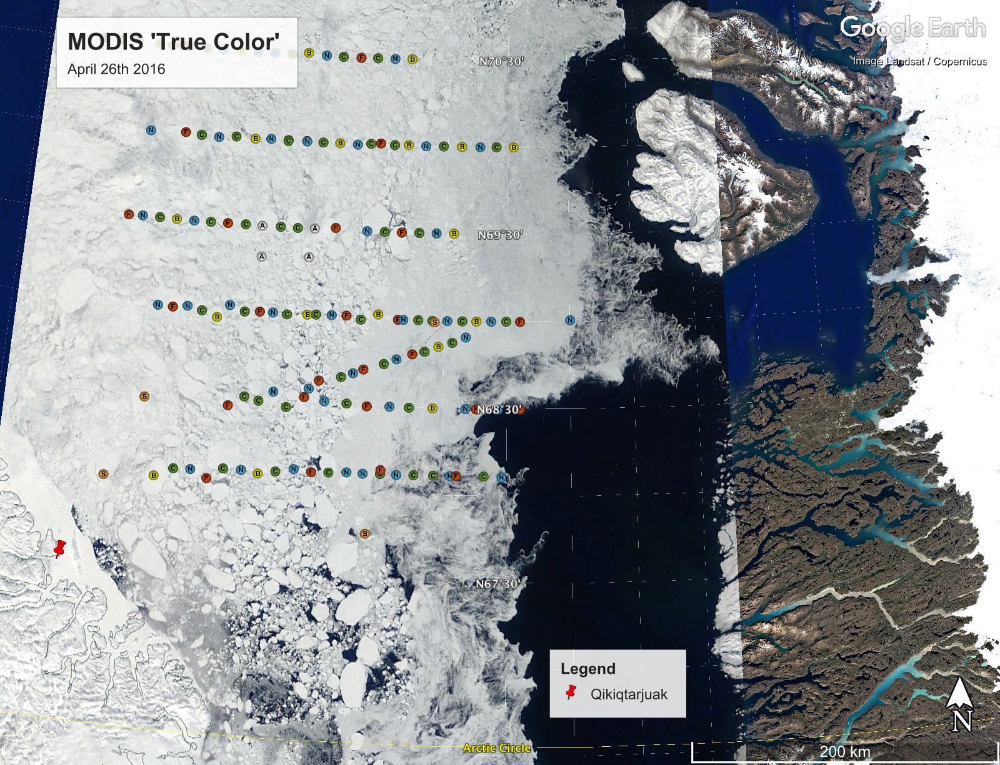

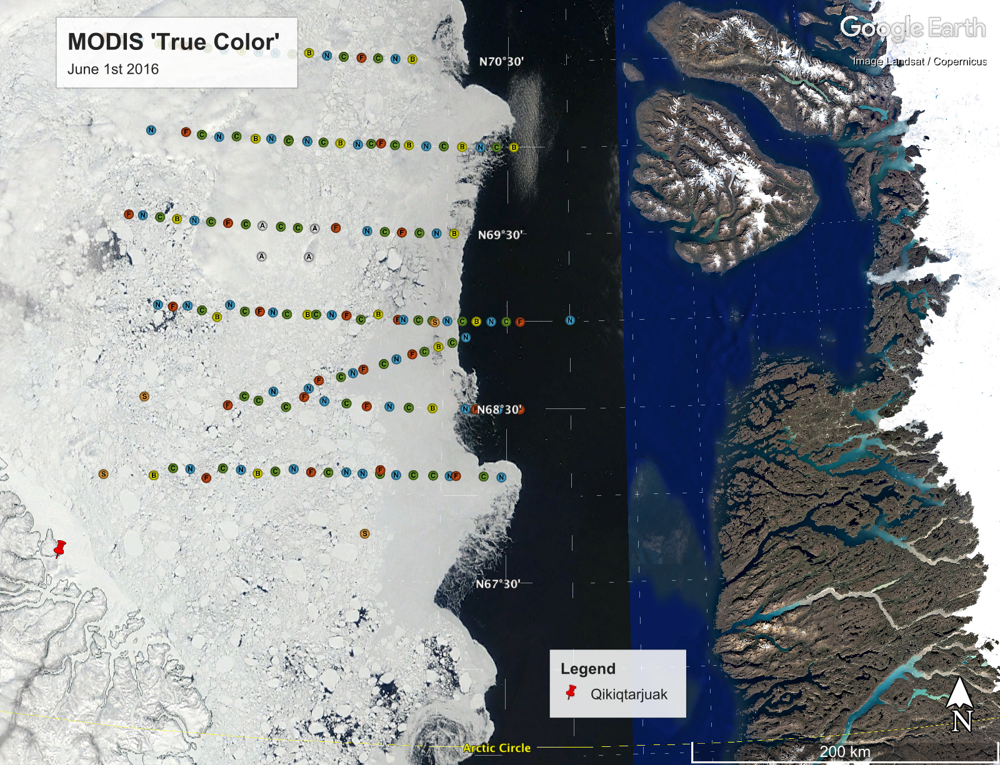

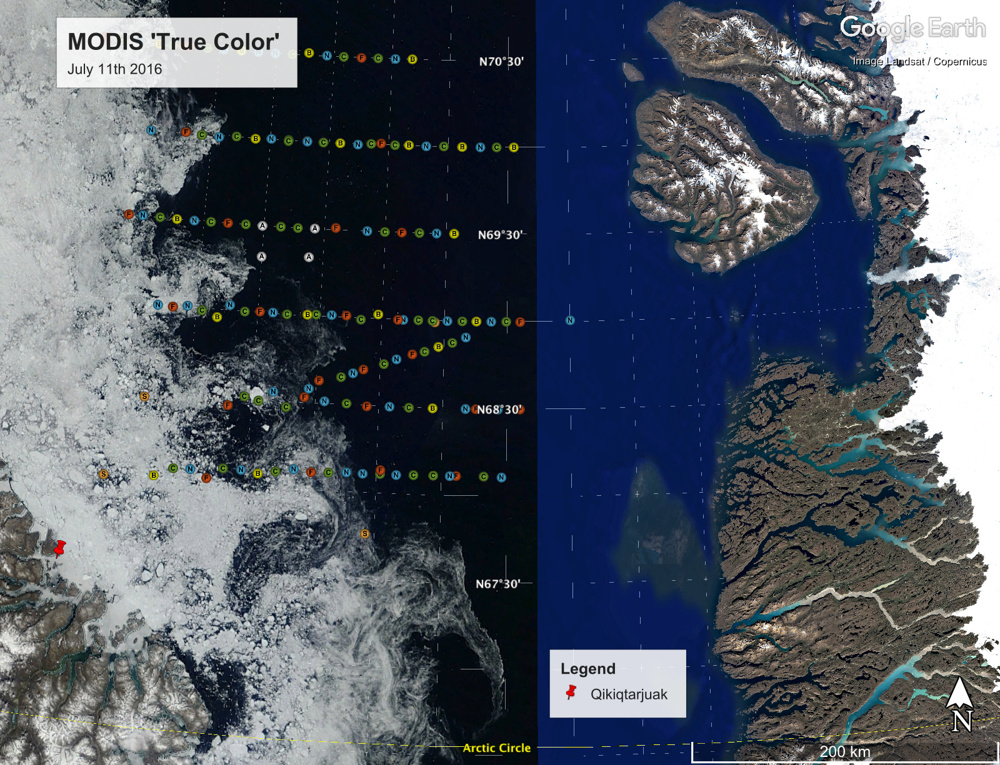

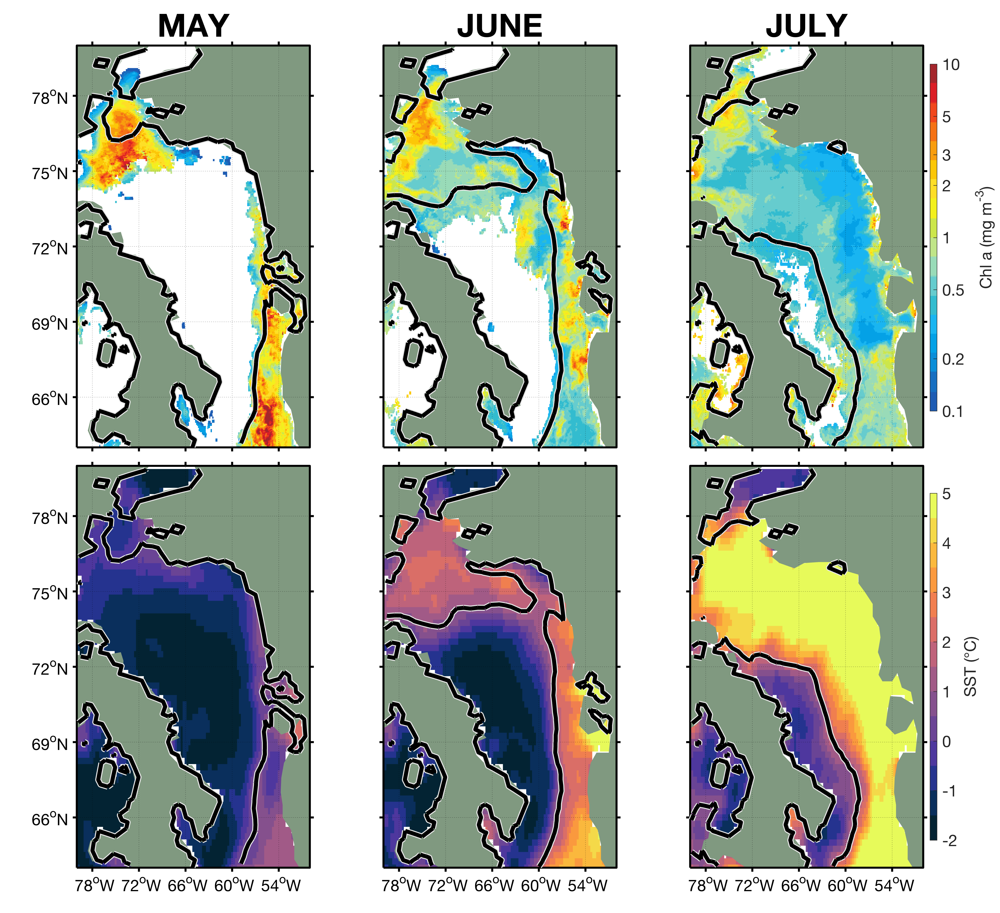

In [3]:
latexImage(fname='coauthor-contributions/laurent/MODIS_TRUE_COLOR_APRIL26.png',
           caption='MODIS true color image from 26 April 2016. Markers show hydrographic stations.',
          label='fig:modis1')
latexImage(fname='coauthor-contributions/laurent/MODIS_TRUE_COLOR_JUNE1.png',
           caption='MODIS true color image from 1 June 2016. Markers show hydrographic stations.',
          label='fig:modis2')
latexImage(fname='coauthor-contributions/laurent/MODIS_TRUE_COLOR_JULY11.png',
           caption='MODIS true color image from 11 July 2016. Markers show hydrographic stations.',
          label='fig:modis3')
latexImage(fname='coauthor-contributions/laurent/CHL_SST_AMU.png',
          caption='Monthly averages of chlorophyll-a and sea surface temperature (SST) in Baffin Bay; \
          the black line shows the ice edge.',
          label='fig:chla-sst',width=1)

# Hydrography -- Some additional figures

Some additional maps of various hydrographic properties, akin to Fig.~6 of the main paper.

In [4]:
ctd=pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc_clustered_scamp_light_tchla.pandas')

ax,latlon2xy,_=map_blueprint(plotbathymetry=False,printmap=False)
ctd=ctd.loc[ctd['Depth']==20]    
x,y = latlon2xy(np.array(ctd['Longitude']),np.array(ctd['Latitude']))

fullvarnames = {
    'Cont_tempMax':'Temperature max ($^\circ$C)',
    'IRD': 'OWD: Open water days, ODS-IDU',
    'ODS': 'ODS: Days of open water since ice retreat',
    'IDU': 'IDU: Days until ice retreat',
    'Depth_mixedLayer': 'Density Mixed Layer depth (m)',
    'Nitracline' : 'Nitracline depth (m)',
    'Depth_chlaMax': 'Chl-a max. depth (m)',
    'iceConc':'Sea ice concentration (\%)',
    'NO3_sfc':'NO$_3^-$ conc. at surface ($\mu$M)',
    'NO3_tempMin': 'NO$_3^-$ conc. at overturning depth ($\mu$M)',
    'DeltaSigth':'$\Delta$ $\sigma_\\theta$ (kg m$^{-3}$)',
    'TChla_vertIntegral_m80':'TChl-a, vertically integrated (mg m$^{-2}$)',
    'isolume_0415': 'Isolume (z at 0.415 mol photons m$^{-2}$ d$^{-1}$)'
}
filenames=[]
captions=[]

varnames = ['Depth_mixedLayer','iceConc',
            'Cont_tempMax',
          'Nitracline','NO3_sfc',
          'Depth_chlaMax','DeltaSigth','IRD','ODS','IDU',
            'TChla_vertIntegral_m80','isolume_0415',
            'NO3_tempMin'
           ]

for k, varname in enumerate(varnames):
    if varname == 'TChla_vertIntegral_m80':
        kwargs=dict(norm=mpl.colors.LogNorm())
    else:
        kwargs=dict()
    
    ax, _, _ = map_blueprint(plotbathymetry=False)
    hc = ax.scatter(x,y,c=ctd[varname],cmap='viridis',zorder=1e5)
    axb = plt.colorbar(hc)

    try:
        fullvar = fullvarnames[varname]
    except:
        fullvar = varname
    
    if varname=='iceConc':
        axb.ax.set_title('Sea ice concentration (%)', horizontalalignment='right')
    else:
        axb.ax.set_title(fullvar, horizontalalignment='right')
    f = 'nb_temp/FIGURE_hydrograph-map_{:s}.png'.format(varname)
    plt.savefig(f)
    filenames.append(f)
    
    cap = '%s (at the time of sampling).'%(fullvar)
    if varname=='Depth_mixedLayer':
        cap = cap+''' For completeness' sake and to make our results comparable with other
            studies, notably the study by \citet{peralta-ferriz2015seasonal}
            mentioned above and Oziel et al.'s companion paper (Oziel et al.,
            2018, this issue), we here computed a mixed layer depth as the shallowest
            depth where potential density exceeds the surface density by
            0.1~kg~m$^{-3}$.  Note, however, that this yields a density mixed
            layer and is therefore extremely shallow under the conditions presented here.'''
    captions.append(cap)
    
    del ax

plt.close('all')

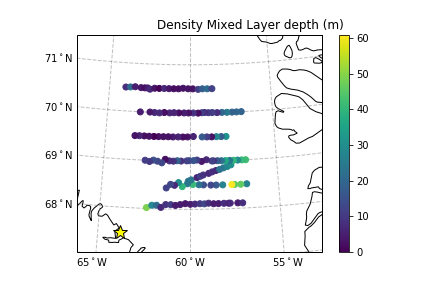

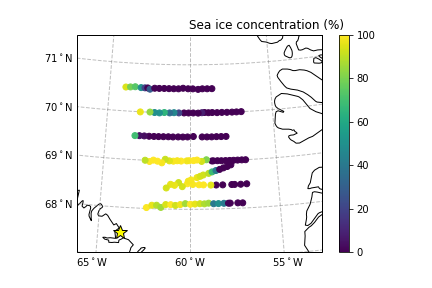

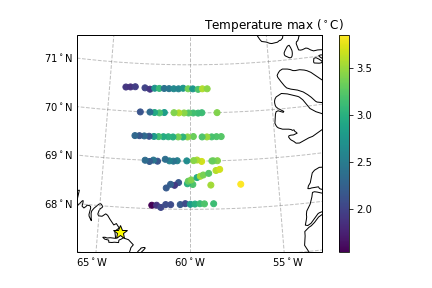

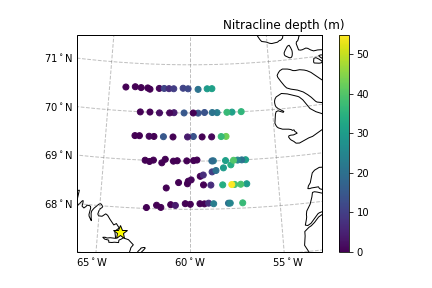

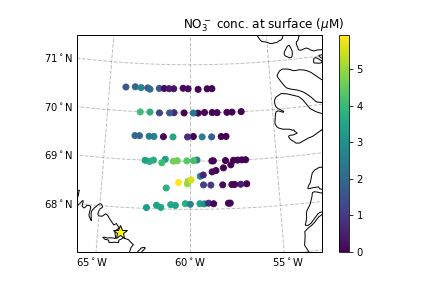

...

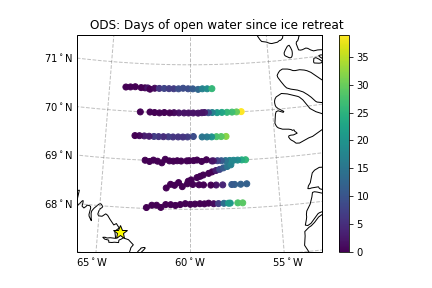

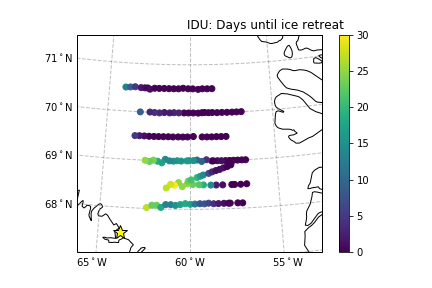

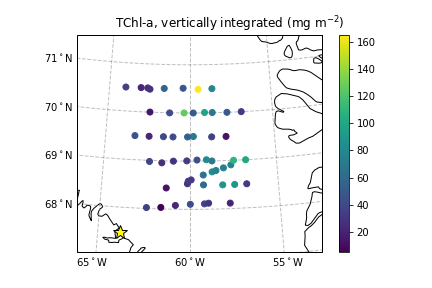

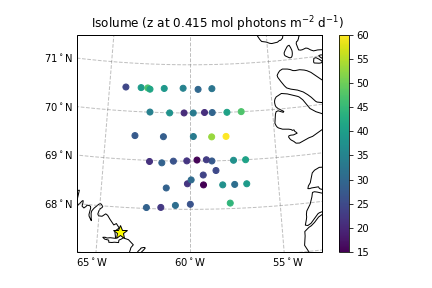

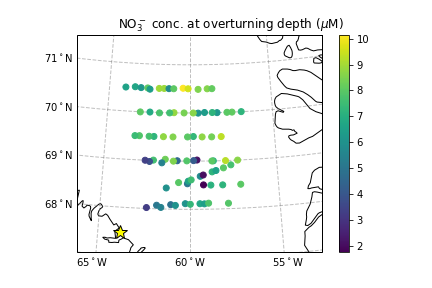

In [5]:
for k,f,var,cap in zip(range(len(filenames)),filenames,varnames,captions):
    latexImage(fname=f,label='supmat:fig:hydrography-map-{:s}'.format(var),caption=cap)

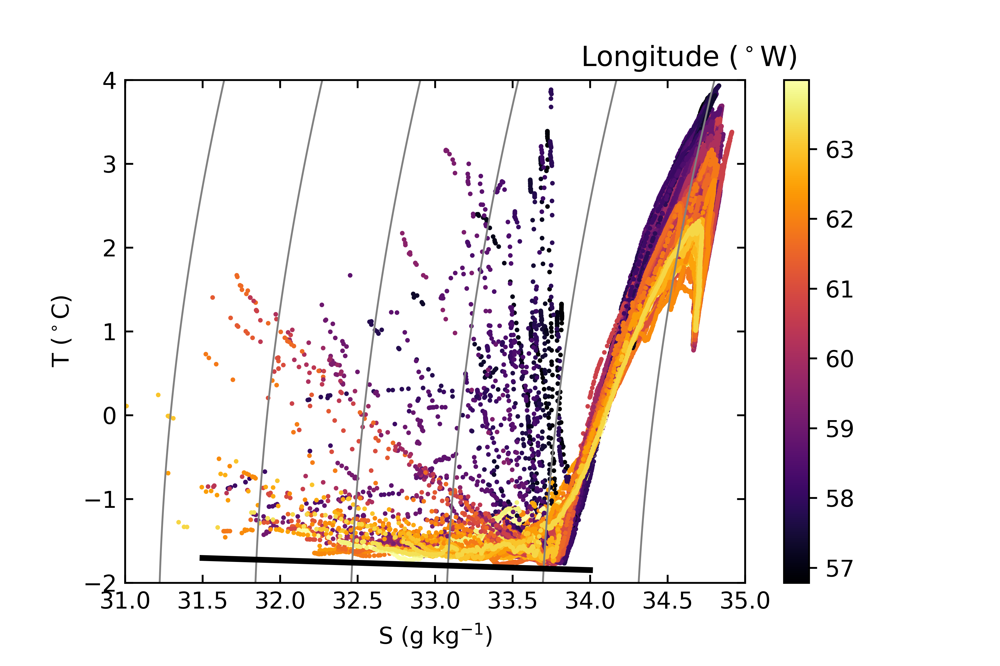

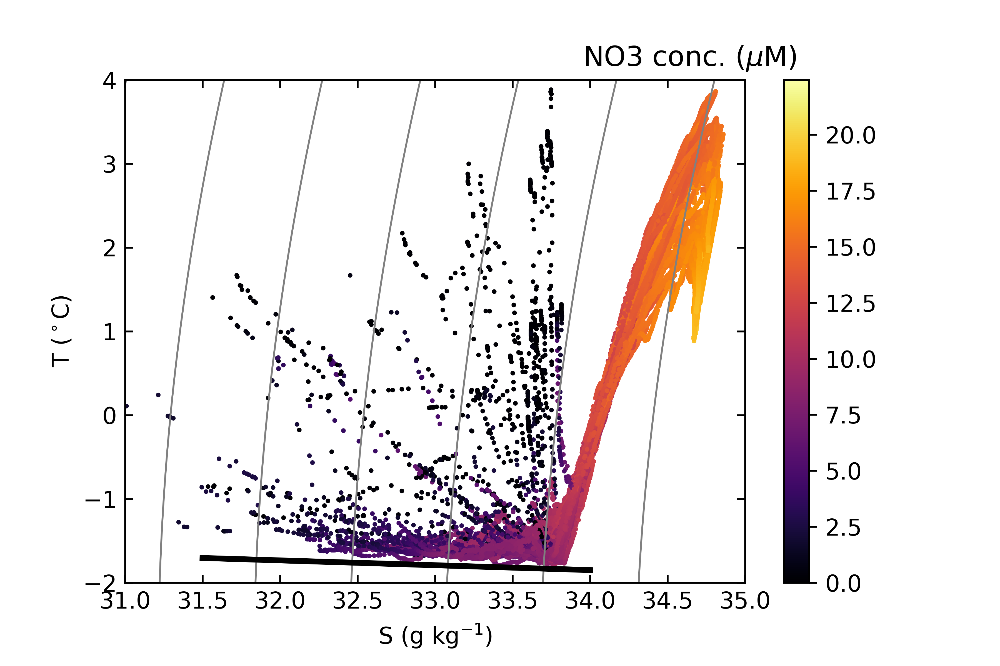

In [6]:
Sgrid = np.linspace(31,35,80)
Tgrid = np.linspace(-2,4,100)
dens = gsw.sigma0(*np.meshgrid(Sgrid,Tgrid))

Sf = np.linspace(31.5,34,10)
Tf = gsw.CT_freezing(Sf,0,0)

from matplotlib.patches import Circle, Wedge, Polygon
from matplotlib.collections import PatchCollection

fnames = []
varnames = ['Longitude','NO3']
for k,var in enumerate(varnames):
    ctd=pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc.pandas')
    s=1

    ctd['Longitude'] *= -1
    fig,ax=plt.subplots()
    if var=='ANP':
        # AW
        ax.add_patch(Polygon(np.c_[[34,34,36,36],[5,1,1,5]], 
                             closed=True, fill=True, facecolor='green',edgecolor='k',
                             zorder=0, alpha=0.2))
        ax.text(34.1,3,'AW',color='k')
        # ArW
        ax.add_patch(Polygon(np.c_[[20,33.5,33.5,20],[-1,-1,-3,-3]], 
                             closed=True, fill=True, facecolor='grey',edgecolor='k',
                             zorder=1e-3, alpha=0.2))
        ax.text(31.1,-1.8,'ArW',color='k')
        # WAW
        ax.add_patch(Polygon(np.c_[[34,33.5,33.5,34],[-1,-1,-3,-3]], 
                     closed=True, fill=True, facecolor='cyan',edgecolor='k',
                             zorder=1e-3, alpha=0.2))
        ax.text(34.1,-1.7,'WAW',color='k')
        ax.plot([34,33.5,33.5,34,34],[-1,-1,-3,-3,-1],'k')
    
    ax.contour(Sgrid,Tgrid,dens,levels=np.arange(24,28,.5),colors='gray',linewidths=.8)
    ax.plot(Sf,Tf,'k',linewidth=2.5)
    hb=ax.scatter(ctd['Asal'],ctd['Cont'],
                c=ctd[var],
                s=s,cmap=plt.get_cmap('inferno'))
    b=plt.colorbar(hb)
    ax.set_xlabel(r'S (g kg$^{-1}$)')
    ax.set_ylabel(r'T ($^\circ$C)')
    ax.set_xlim(31,35)
    ax.set_ylim(-2,4)
    if var=='Longitude':
        b.ax.set_title('Longitude ($^\circ$W)',horizontalalignment='right')
    elif var=='NO3':
        b.ax.set_title('NO3 conc. ($\mu$M)',horizontalalignment='right')
        
    ax.tick_params(top=True, right=True, direction='in')
    plt.savefig('nb_temp/FIG_TS_{:s}.pdf'.format(var))
    f = 'nb_temp/FIG_TS_{:s}.png'.format(var)
    plt.savefig(f,dpi=600)
    fnames.append(f)
    
plt.close('all')

commoncap = 'T-S plot. The color scale represents '
captions=['Depth','the ANP tracer','Longitude','NO$_3$ concentration']
for k,f,var,cap in zip(range(len(fnames)),fnames,varnames,captions):
    latexImage(fname=f,label='supmat:fig:TS-'+var,caption=commoncap+cap+'.')

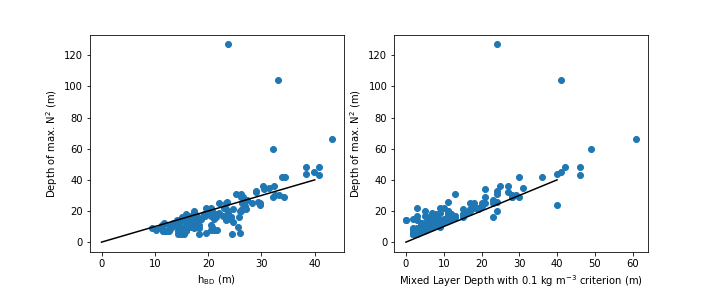

In [7]:
ctd = pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc_clustered_scamp_light_tchla.pandas')

ctd['dSIGdz'] = ctd.groupby('Station')['SIGP_01'].diff().rolling(4).mean()
c = (
    ctd[['dSIGdz', 'Station', 'Depth']]
    .set_index('Depth')
    .groupby('Station').idxmax()
    .rename(columns=dict(dSIGdz='Depth_maxN2'))
    .reset_index()
)


ctd = ctd.merge(c, on='Station').groupby('Station').first()

fig, axs = plt.subplots(1,2, figsize=(10,4))
ax=axs[0]
ax.scatter(ctd.hBD, ctd.Depth_maxN2)
ax.plot([0,40],[0, 40], 'k')
ax.set_xlabel('h$_\mathrm{BD}$ (m)')
ax.set_ylabel('Depth of max. N$^2$ (m)')
ax=axs[1]
ax.scatter(ctd.Depth_mixedLayer, ctd.Depth_maxN2)
ax.plot([0,40],[0, 40], 'k')
ax.set_xlabel('Mixed Layer Depth with 0.1 kg m$^{-3}$ criterion (m)')
ax.set_ylabel('Depth of max. N$^2$ (m)')
plt.savefig('nb_temp/FIG_MLD_comparisons.png')

plt.close('all')
latexImage(fname='nb_temp/FIG_MLD_comparisons.png',
          label='supmat:fig:MLD_comparisons',
          caption="""The depth of maximum N$^2$ compared to (left) the equivalent mixed layer depth h$_\mathrm{BD}$,
           and (right) a classical mixed layer depth defined by a 0.1 kg m$^{-3}$ threshold. 
           Solid black line: 1:1 relation.""",
          width=1.)

# Sea Ice and Open Water Days

The "open water days" (OWD) parameter is defined as follows. First, we fix a time interval that captures the full sea ice variability in the region of interest, say from a date $T_0$ (here, taken to be doy 120, April 29) before the melt starts, to a later date $T_e$ when the ice extent has disappeared from the study area (here, doy 210, July 28). We then define the number of "open water days since sea ice retreat" (ODS) at a given location at time $T_0<t<T_e$ by simply summing the days where $c<15\%$ since $T_0$, and the number of "Ice days until sea ice retreat" (IDU) by summing the days where $c>15\%$ until $T_e$. Then OWD $\equiv$ ODS$-$IDU. Because the ice edge retreats steadily (does not meander much or go back and forth), there are very few sampling stations where IDU and ODS are both non-zero (Fig. S\ref{supmat:fig:ODS-vs-IDU}). This was one of the reasons to conduct the experiment there in the first place and facilitates the analysis of the ice edge bloom. An instance where IDU and ODS are both non-zero will occur whenever a location has open water one day, but later on becomes ice covered again before the end of the melt season. 

The steady retreat of the ice edge is demonstrated mainly by two facts: 1) ODS (Open water Days Since ice retreat) vs. IDU (Ice cover Days Until ice retreat) did not have much overlap where both are non-zero, and 2) there is a good correlation between distance from the ice edge and OWD (Open Water Days, defined as OWD $\equiv$ ODS$-$IDU)

The plot immediately below also demonstrates that as a consequence, an alternative definition of OWD, namely OWD=IDS when ice concentration is smaller than 15%, and OWD = $-$IDU when ice concentration is larger than 15%, leads to largely identical values.

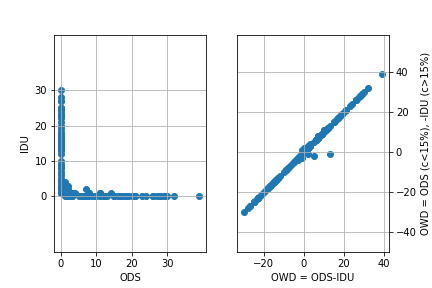

In [8]:
ctd = pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc.pandas')
a=ctd.groupby('Station').mean()

fig,axs=plt.subplots(1,2,sharey=False)
ax=axs[0]
ax.scatter(a['ODS'],a['IDU'])
ax.set_xlabel('ODS')
ax.set_ylabel('IDU')
ax.set_xticks(range(0,40,10))
ax.set_yticks(range(0,40,10))
ax.grid()
ax.axis('equal')
ax=axs[1]
ax.scatter(a['IRD'],a['IRD2'])
ax.set_xlabel('OWD = ODS-IDU')
ax.set_ylabel('OWD = ODS (c<15%), -IDU (c>15%)')
ax.yaxis.tick_right()
ax.yaxis.set_label_position('right')
ax.set_xticks(range(-40,50,20))
ax.set_yticks(range(-40,50,20))
ax.grid()
ax.axis('equal')
plt.savefig('nb_temp/FIG_ODS-vs-IDU.png')

plt.close('all')
latexImage(fname='nb_temp/FIG_ODS-vs-IDU.png',
          label='supmat:fig:ODS-vs-IDU',
          caption='''
          Left: Days until the ice retreats vs. days since the ice has retreated. 
          Right: Comparison of two different criteria to define the OWD variable.
          ''')

# Light

## Underwater light measurements using the C-OPS

The C-OPS is an oceanographic instrument composed of a surface reference downwelling irradiance sensor, E$_\mathrm{d}^{0+}(\lambda)$, as well as a set of two free-fall profiling radiometers (maximum depth of 125 m), namely a downwelling irradiance one, E$_\mathrm{d}(z,\lambda)$, and either a upwelling irradiance one, E$_\mathrm{u}(z,\lambda)$, or an upwelling radiance one, L$_\mathrm{u}(z,\lambda, \phi)$. Here, $\mathrm{z}$ denotes the depth, $\lambda$ the wavelength and $\phi$ the viewing angle (nadir in our case). These sensors record their respective radiometric quantity along nineteen wavelengths, spread in the visible spectrum, from 320 nm to 875 nm. An ice floe version of this instrument, the so-called IcePRO, has been designed for deployment through an auger hole in an ice floe. (Once the IcePRO has been deployed in the hole, fresh snow is shoveled back in the hole before the profiling starts. This prevents any artificial bright spot just above the sensors.) Both versions have been used during the Green Edge project.
The sensors have been factory calibrated before the cruise (January 2015 and February 2016), and a custom R code following the well recognized methodology originally published by \citet{smith1984analysis} has been used to process the data.  Furthermore, a PAR was computed from all the available multispectral irradiances values (in and above surface, downwelling and upwelling), following $$PAR_d(\mathrm{z}) = \int_{\lambda=400~\textrm{nm}}^{\lambda=700~\textrm{nm}}E_\mathrm{d}(\mathrm{z},\lambda)\frac{\lambda}{\mathrm{hc}}d\lambda$$Here, $\mathrm{h}$ is Planck's constant and $\mathrm{c}$ is the speed of light in vacuum, and the summing is performed using a trapezoidal method.

When the data acquisition was performed in open water, the in-water radiometric quantities were extrapolated until $\mathrm{z=0^-}$, i.e. up to just under the surface, and when the data acquisition was performed under the ice, no extrapolation was performed, and the shallowest valid data point has been kept.

From the derived $\mathrm{PAR_d(z)}$ and $\mathrm{PAR^{0+}}$ quantities, a transmission profile was computed as $$\mathrm{t(z) = \frac{PAR_d(z)}{PAR^{0+}}}$$ This transmission profile includes the transmission loss due to the snow/sea ice layer, plus any water layer being between surface sensor and the profiling sensor when it is at the depth $\mathrm{z}$. 

For no C-OPS station was it the case that it was both 1) sampled on
ice \emph{and} 2) AMSR2 indicated ice concentrations below 80\%,
indicating a good match between in-situ sampling conditions and ice concentrations inferred by AMSR2.

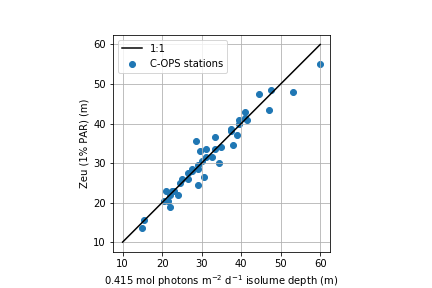

In [9]:
par = pd.read_pickle('nb_temp/GE2016_PAR.pandas')
par=par.loc[par['Depth']==3]

fig,ax=plt.subplots()
plt.scatter(par['isolume_0415'],par['Zeu'])
plt.plot([10,60],[10,60],'k',zorder=1e4)
plt.axis('square')
plt.xlabel('0.415 mol photons m$^{-2}$ d$^{-1}$ isolume depth (m)')
plt.ylabel('Zeu (1% PAR) (m)')
plt.grid()
plt.legend(['1:1','C-OPS stations'])
plt.savefig('nb_temp/FIG_GE2016_Amundsen_isolume4.png')

# from scipy.stats import ttest_1samp as tt
# print(tt(par.isolume_0415-par.Zeu, 0))

import statsmodels.api as sm
res = sm.OLS(par.isolume_0415-par.Zeu, par.Zeu).fit()


plt.close('all')
latexImage(fname = 'nb_temp/FIG_GE2016_Amundsen_isolume4.png',
          label='supmat:fig:isolume-vs-zeu',
          caption="""
          The 0.415 mol photons m$^{-2}$ d$^{-1}$ isolume plotted against the 1 \% PAR level, 
          a common definition of the euphotic zone depth.
          The slope as determined by a linear regression is not significantly different from one.
          """)

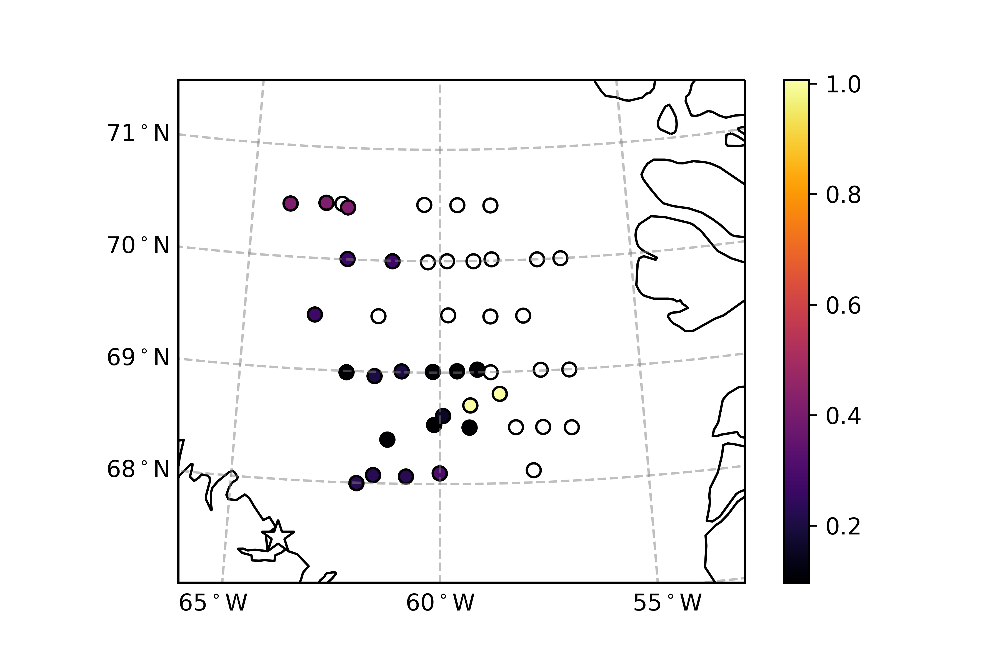

In [10]:
par = pd.read_pickle('nb_temp/GE2016_PAR.pandas')
par=par.loc[par['Depth']==3]

ax,latlon2xy,_ = map_blueprint(plotbathymetry=False,
                      icecampmarkercolor='w',
                              )
ax.scatter(*latlon2xy(np.array(par['longitude']),np.array(par['latitude'])),
          edgecolors='k',facecolors='w')
hc=ax.scatter(*latlon2xy(np.array(par['longitude']),np.array(par['latitude'])),
           c=par['iceTransmittance'],
              edgecolors='k',
        cmap=plt.get_cmap('inferno'))
plt.colorbar(mappable=hc)
plt.savefig('nb_temp/FIG_ice-transmittance.png',dpi=600)
plt.close('all')
latexImage(fname='nb_temp/FIG_ice-transmittance.png',
          caption='The combined ice+snow transmittance where available; empty circles mean \
          that measurements were not done from the ice. \
          Estimated from C-OPS measurements as the ratio between downwelling PAR \
          irradiance directly under sea ice and the simultaneously measured \
          incoming above-surface PAR.',
          label='supmat:fig:ice-trans')

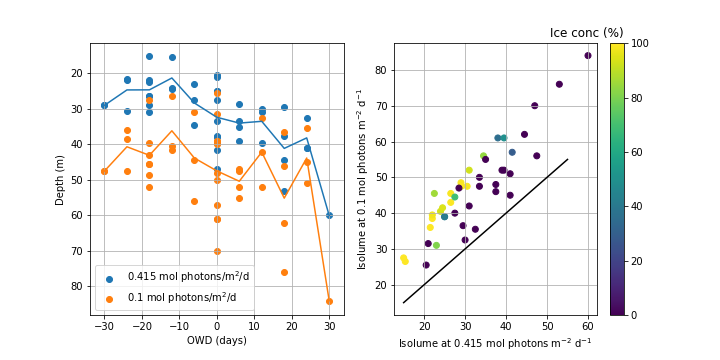

In [11]:
ctd=pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc_clustered_scamp_light_tchla.pandas')
ctd=ctd.loc[ctd['Depth']==10]

step=6
bins=np.arange(ctd['IRD'].min()-0.5*step,ctd['IRD'].max(),step)
ctd['IRD']=pd.cut(ctd['IRD'],
                  bins=bins,
               labels=bins[:-1]+0.5*step).astype('float')
a=ctd.groupby(['IRD','Depth']).mean().reset_index().set_index('Station')

fig,axs=plt.subplots(1,2,figsize=(10,5))
ax=axs[0]
ax.scatter(ctd['IRD'],ctd['isolume_0415'])
ax.scatter(ctd['IRD'],ctd['isolume_01'])
ax.legend(['0.415 mol photons/m$^2$/d','0.1 mol photons/m$^2$/d'])
ax.plot(a['IRD'],a['isolume_0415'])
ax.plot(a['IRD'],a['isolume_01'])
ax.invert_yaxis()
ax.set_xlabel('OWD (days)')
ax.set_ylabel('Depth (m)')
ax.grid()

ax=axs[1]
h=ax.scatter(ctd['isolume_0415'],ctd['isolume_01'],c=ctd['iceConc'])
ax.plot([15,55],[15,55],'k')
hcb=plt.colorbar(mappable=h)
hcb.ax.set_title('Ice conc (%)',loc='right')
ax.set_xlabel('Isolume at 0.415 mol photons m$^{-2}$ d$^{-1}$')
ax.set_ylabel('Isolume at 0.1 mol photons m$^{-2}$ d$^{-1}$')
ax.grid()


plt.savefig('nb_temp/FIG_isolume-comparison.png')
plt.close('all')
latexImage(fname='nb_temp/FIG_isolume-comparison.png',
          caption='Isolumes compared between the 0.1 and the 0.415 mol photons m$^{-2}$ d$^{-1}$ light levels.',
          label='supmat:fig:isolume-comparison')

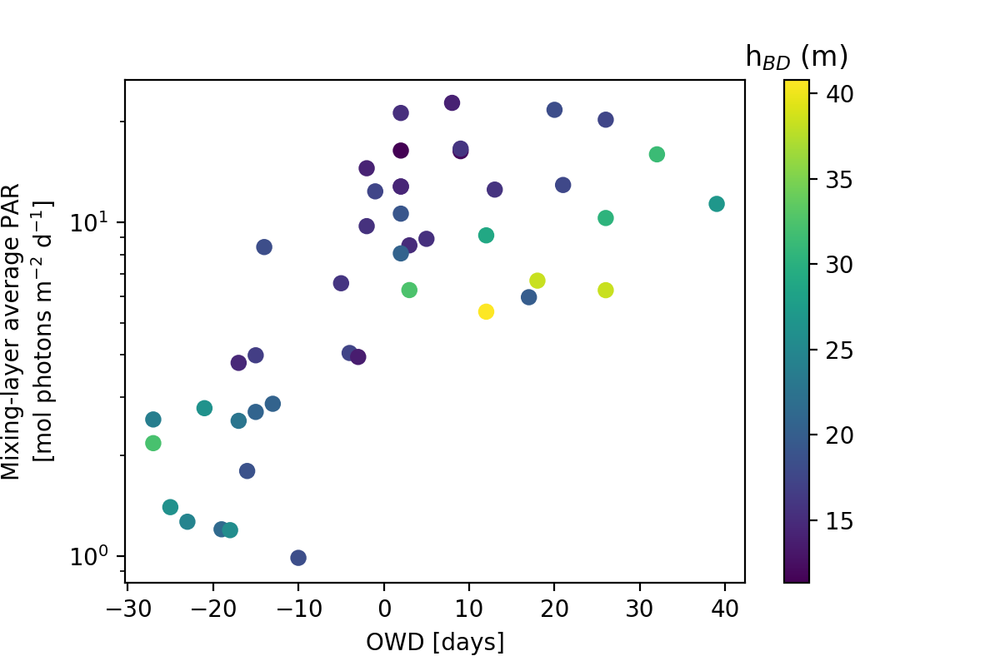

In [12]:
ctd=pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc_clustered_scamp_light_tchla.pandas')
ctd=ctd.loc[ctd['Depth']==10]


plt.scatter(ctd['IRD'],ctd['PAR_avg_hBD'],c=ctd['hBD'])#,norm=mpl.colors.LogNorm())
plt.yscale('log')
cb=plt.colorbar()
cb.ax.set_title('h$_{BD}$ (m)')
plt.ylabel('Mixing-layer average PAR\n[mol photons m$^{-2}$ d$^{-1}$]')
plt.xlabel('OWD [days]')
plt.savefig('nb_temp/FIG_PAR_avg_hBD.png',dpi=200)
plt.close('all')
latexImage(fname='nb_temp/FIG_PAR_avg_hBD.png',
          label='supmat:fig:par-avg-hbd',
          caption='PAR irradiance averaged over the equivalent mixed layer depth h$_{BD}$.')

## Above-surface PAR irradiance

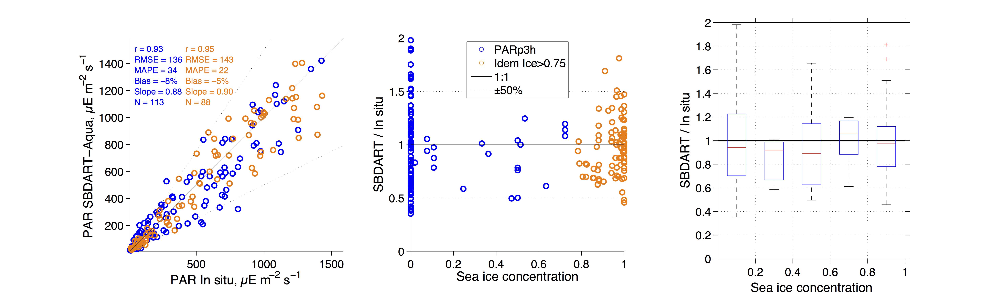

In [13]:
latexImage(fname='coauthor-contributions/C-OPS-report-Fig6-SBDART-vs-insitu.png',
          label = 'supmat:fig:par0-validation',
          caption='''
          Scatterplot for the Amundsen cruise and a period of 3h prior to sampling (left),
          model/measurement ratio sorted by sea ice concentration (center),
          and boxplot of the model/measurement 
          ratio sorted by five sea ice concentration categories (right)
          ''',
          width=1.0)

# "Arctic" vs. "Atlantic" domains

\label{sec:cluster}

The fuzzy c-means clustering algorithm \citep{ross2010fuzzy}
(implemented in python's \emph{skfuzzy} library\citep{scikit-imageteamskfuzzy}) assigns
a membership value $\in$[0,1] to each data point. All data points, characterized by a number of properties, are sorted into a pre-defined number of clusters (here, two).

Consequently, based on a few select properties, each
hydrographic station is assigned a value between  0
and 1, where 0 and 1 themselves correspond to exclusive membership in either cluster, and values
in between represent the statistical uncertainty in the attribution
(fuzziness). 

The following properties were included, centered and
normalized: (1) maximum temperature in the AW layer, (2) salinity at
the estimated convection depth, and (3) ANP at 20~m depth, which
summarize the strength of Atlantic inflow and the resulting
hydrography and nutrient composition. The clustering reproduced as
expected the longitudinal gradient present in the majority of all variables.

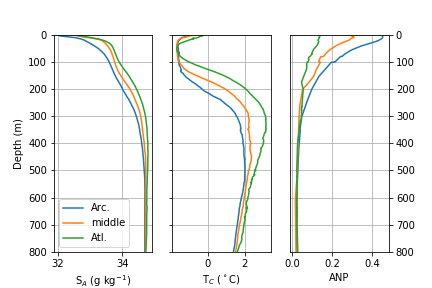

In [14]:
ctd=pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc_clustered.pandas')
ctd['cluster']=pd.cut(ctd['cluster'],bins=[0,.1,.9,1.],labels=[0,.5,1])#.astype('float')
ctd=ctd.groupby(['cluster','Depth']).mean().reset_index()

fig,axs = plt.subplots(1,3)
for cl in [0,.5,1]:
    c=ctd.loc[ctd['cluster']==cl]
    axs[0].plot(c['Asal'],c['Depth'])
    axs[1].plot(c['Cont'],c['Depth'])
    axs[2].plot(c['ANP'],c['Depth'])
    
for i in range(3):
    axs[i].set_ylim(0,800)
    axs[i].invert_yaxis()  
    axs[i].grid(True)
axs[1].set_yticklabels([])
axs[2].yaxis.tick_right()
axs[0].set_ylabel('Depth (m)')
axs[0].legend(['Arc.','middle','Atl.'])
axs[0].set_xlabel('S$_A$ (g kg$^{-1}$)')
axs[1].set_xlabel('T$_C$ ($^\circ$C)')
axs[2].set_xlabel('ANP')
plt.savefig('nb_temp/FIG_hydrography_clustered.png')
plt.close('all')
latexImage(fname='nb_temp/FIG_hydrography_clustered.png',
          label='fig:hydrography-clustered',
          caption='Salinity, temperature, and ANP tracer averaged in bins 0 < 0.1 < 0.9 < 1 of the clustering coefficient.')

# Winter overturning depth and the associated pre-bloom nutrient inventory

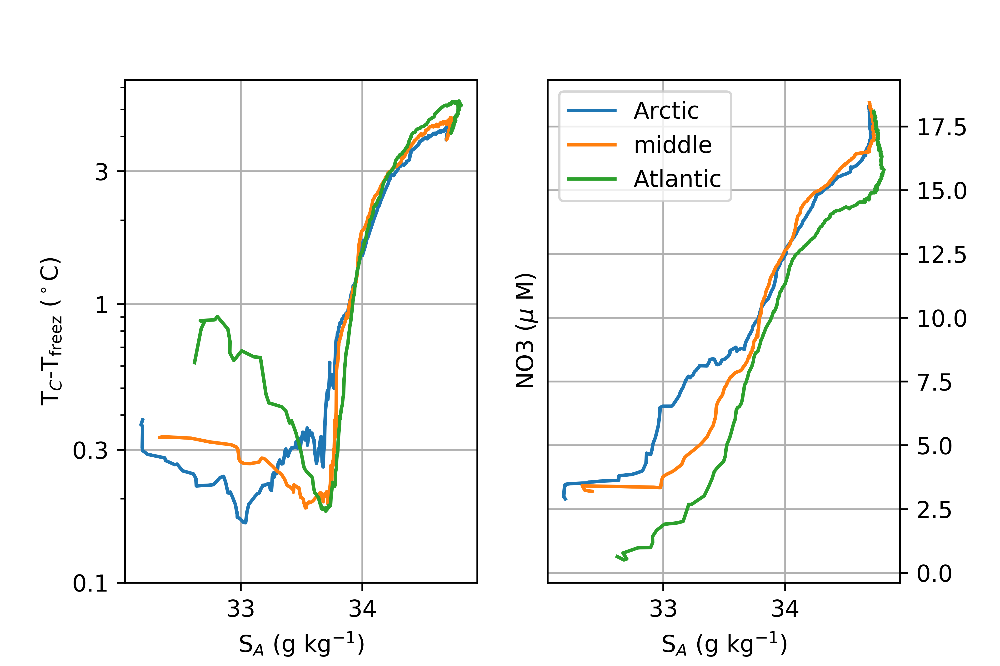

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
plt.close("all")

ctd = pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc_clustered.pandas')
ctd=ctd[ctd['Depth']<800]

ctd['cluster']=pd.cut(ctd['cluster'],bins=[0,.1,.9,1.],labels=[0.,.5,1])
ctd=ctd.groupby(['cluster','Depth']).median().reset_index()

fig,ax=plt.subplots(1,2)
ctd.groupby('cluster').plot(x='Asal',y='DeltaT',ax=ax[0],legend=False)
ax[0].set_yscale('log')
ax[0].set_yticks([.1,.3,1,3])
ax[0].set_yticklabels([.1,.3,1,3])
ctd.groupby('cluster').plot(x='Asal',y='NO3',ax=ax[1],legend=False)
ax[1].yaxis.tick_right()
for i in range(2):
    ax[i].grid(True)
    ax[i].set_xlabel('S$_A$ (g kg$^{-1}$)')
ax[0].set_ylabel('T$_C$-T$_\mathrm{freez}$ ($^\circ$C)')
ax[1].set_ylabel('NO3 ($\mu$ M)')
plt.legend(['Arctic','middle','Atlantic'])
plt.savefig('nb_temp/FIG_TSNO3.pdf')
plt.savefig('nb_temp/FIG_TSNO3.png',dpi=700)
plt.close('all')

latexImage(fname = 'nb_temp/FIG_TSNO3.png',
           label = 'supmat:fig:tsno3',
           caption='''Left: Freezing point deviation plotted against salinity, split by 
           hydrographic domain. For individual profiles, 
           see Figs.~S\\ref{fig:overturning-depth-check} and S\\ref{fig:overturning-depth-check-2}.
           Right: Nitrate concentrations against salinity split by hydrographic domain. Although somewhat skewed 
           because surface nitrate consumption had progressed more in the Atlantic than the Arctic domain, 
           it shows how winter overturning to more saline layers gives access to more pre-bloom nitrate.
           ''')

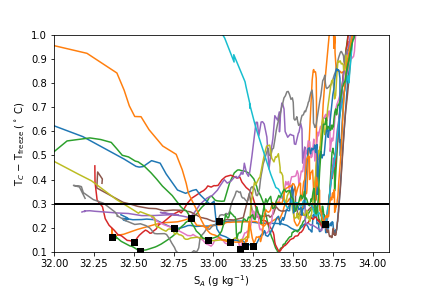

In [2]:
ctd=pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc_clustered.pandas'
                  ).reset_index()
ctd=ctd.set_index('Asal')
ctd=ctd.loc[ctd['cluster']<.1]

ctd.groupby('Station')['DeltaT'].plot()
plt.plot(ctd['Asal_tempMin'],ctd['DeltaT_tempMin'],'ks')
plt.xlim(32,34.1),
plt.ylim(0.1,1)

plt.xlabel('S$_A$ (g kg$^{-1}$)')
plt.ylabel('T$_C$ $-$ T$_\mathrm{freeze}$ ($^\circ$ C)')
plt.plot([0 ,200],[.3, .3],'k',lw=2)
plt.savefig('nb_temp/FIG_overturning_depth_check.png')
plt.close('all')
latexImage(fname='nb_temp/FIG_overturning_depth_check.png',
           label='fig:overturning-depth-check',
          caption='Temperature-salinity diagram showing detected temperature minima (black) in the "Arctic" domain.')

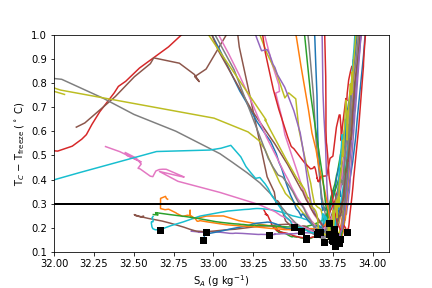

In [3]:
ctd=pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc_clustered.pandas'
                  ).reset_index()
ctd=ctd.set_index('Asal')
ctd=ctd.loc[ctd['cluster']>.9]

ctd.groupby('Station')['DeltaT'].plot()
plt.plot(ctd['Asal_tempMin'],ctd['DeltaT_tempMin'],'ks')
plt.xlim(32,34.1),
plt.ylim(0.1,1)

plt.xlabel('S$_A$ (g kg$^{-1}$)')
plt.ylabel('T$_C$ $-$ T$_\mathrm{freeze}$ ($^\circ$ C)')
plt.plot([0 ,200],[.3, .3],'k',lw=2)
plt.savefig('nb_temp/FIG_overturning_depth_check.png')
plt.close('all')
latexImage(fname='nb_temp/FIG_overturning_depth_check.png',
           label='fig:overturning-depth-check-2',
          caption='Temperature-salinity diagram showing detected minima (black) in the "Atlantic" domain.')

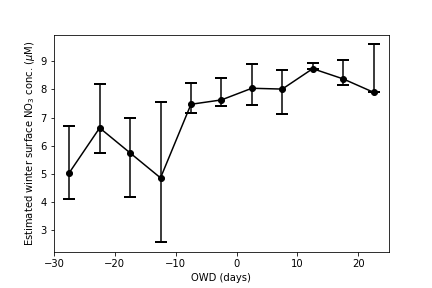

In [18]:
ctd = pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc_clustered_scamp_light_tchla.pandas')
ctd['IRD']=pd.to_numeric(pd.cut(ctd['IRD'],bins=np.arange(-30,30,5),labels=np.arange(-27.5,27.5,5)))
ctd = ctd.groupby('IRD').describe().reset_index()

plt.errorbar(x=ctd['IRD'],
             y=ctd['NO3_tempMin']['50%'],
             yerr = [ctd['NO3_tempMin']['75%']-ctd['NO3_tempMin']['50%'],
                    ctd['NO3_tempMin']['50%']-ctd['NO3_tempMin']['25%']],
             marker='.',capsize=6,capthick=2,markersize=12,color='k')
plt.xlabel('OWD (days)')
plt.ylabel('Estimated winter surface NO$_3$ conc. ($\mu$M)')

plt.savefig('nb_temp/FIG_winter_NO3_vs_OWD.png')
plt.close('all')
latexImage(fname='nb_temp/FIG_winter_NO3_vs_OWD.png',
          caption='''Winter surface concentration of nitrate taken as nitrate concentration at the estimated winter overturning salinity, 
          plotted against the number of open water days. Note that in the easternmost stations (high OWD values), phytoplankton growth may have decreased 
          nitrate concentrations at the winter overturning depth, and there winter surface concentrations may be more in the 10 $\mu$M range.
          ''',
          label='supmat:fig:winter-no3-owd')

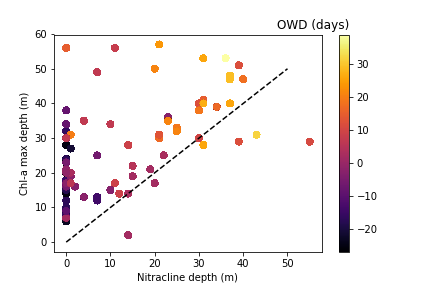

In [19]:
ctd=pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts_ice_1dprop_sfc.pandas')

plt.scatter(ctd['Nitracline'],ctd['Depth_chlaMax'],c=ctd['IRD'],cmap=plt.get_cmap('inferno'))
cb=plt.colorbar()
cb.ax.set_title('OWD (days)',loc='right')
plt.plot([0,50],[0,50],'k--')
plt.xlabel('Nitracline depth (m)')
plt.ylabel('Chl-a max depth (m)')
plt.savefig('nb_temp/FIG_nitracline-vs-chlamax.png')
plt.close('all')
latexImage(fname='nb_temp/FIG_nitracline-vs-chlamax.png',
          caption='The chl-a maximum stayed below the nitracline at most stations.',
          label='supmat:fig:nitracline-vs-chlamax')

# Pacific and Atlantic water masses as separated by the phosphorus-nitrogen signature

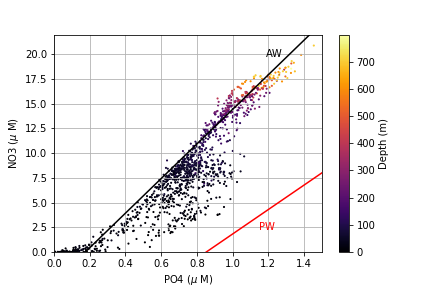

In [20]:
import pandas as pd
import matplotlib.pyplot as plt
plt.close("all")

ctd = pd.read_pickle('nb_temp/GE2016_Amundsen_hydrography_data_includes_nuts.pandas')
ctd=ctd[ctd['Depth']<800]

fig,ax=plt.subplots()
plt.scatter(ctd['PO4'],ctd['NO3'],
            c=ctd['Depth'],
            s=1.2,cmap=plt.get_cmap('inferno'),vmin=0)
b=plt.colorbar()
b.ax.set_ylabel('Depth (m)')#T$_{max}$')
plt.xlabel('PO4 ($\mu$ M)')
plt.ylabel('NO3 ($\mu$ M)')
plt.grid()
PO4 = np.linspace(0,2,200)
NO3AW = 17.499 * PO4 -3.072
NO3PW = 12.368 * PO4 -10.549
plt.plot(PO4,NO3AW,'k')
plt.plot(PO4,NO3PW,color='r')
plt.text(1.28,20.0,'AW',horizontalalignment='right',verticalalignment='center',color='k')
plt.text(1.15,2.5,'PW',horizontalalignment='left',verticalalignment='center',color='r')
plt.ylim(0,22)
plt.xlim(0,1.5)
plt.savefig('nb_temp/FIG_nut.png')
plt.close('all')
latexImage(fname = 'nb_temp/FIG_nut.png',
           caption='Nitrate vs phosphate, also showing regression relations by \citet{jones1998distribution}.',
            label='fig:nutrients')

# Chlorophyll-a

Integrating only over the full HPLC profile will underestimate integrated chl-a whenever the last HPLC value did not cover the entire fluorescence profile. In other words, integrating the calibrated chl-a fluorescence profile until the depth where fluorescence reaches 1\% of its maximum value will yield a somewhat larger value.

The following two figures demonstrate that uniformly integrating HPLC-determined total chlorophyll-a to a depth of 80 m misses little overall biomass.


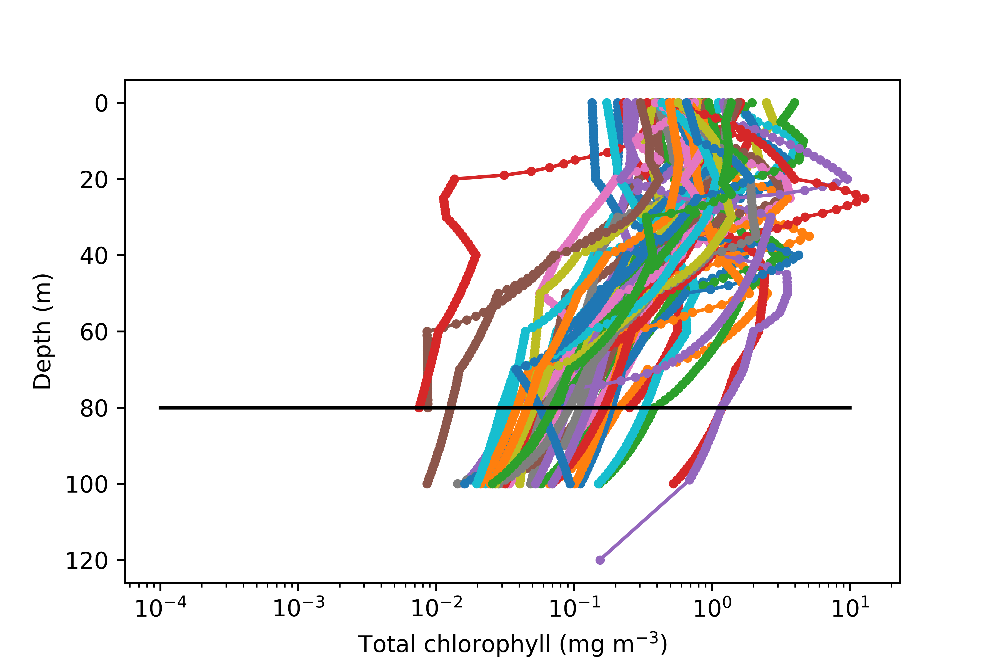

In [21]:
chl=pd.read_pickle('nb_temp/GE2016_total_chlorophyll.pandas')
fig,ax=plt.subplots()
_=chl.reset_index().groupby('Station').plot(
    x='Total Chlorophyll a',y='Depth (m)',ax=ax,
    legend=False,logx=True,
    marker='.')
ax.invert_yaxis()
ax.set_ylabel('Depth (m)')
ax.set_xlabel('Total chlorophyll (mg m$^{-3}$)')
ax.plot([1e-4,1e1],[80,80],'k')
plt.savefig('nb_temp/FIG_chla-profiles.png',dpi=600)
plt.close('all')
latexImage(fname='nb_temp/FIG_chla-profiles.png',
          caption='Vertical profiles of total chlorophyll-a as measured by HPLC, showing that very \
          little biomass is lost by uniformly integrating from 0 to 80 m depth.',
          label='supmat:fig:chla-profiles')

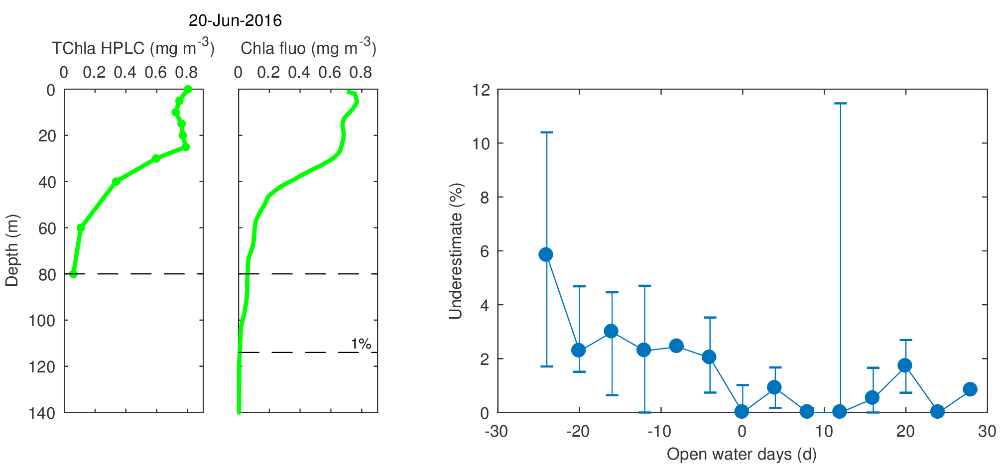

In [22]:
latexImage(fname='coauthor-contributions/leo/underestimate_A16.png',
          label = 'supmat:fig:leo',
          caption='''Underestimation of total chlorophyll by integration of HPLC-determined profiles to 80 m, 
          vs. closing them using CTD/rosette-based fluorescence sensor.
          Left panel: Two exemplary profiles of HPLC-determined total chlorophyll, 
          and the corresponding CTD fluorescence sonde output (bias removed and smoothed using a 5-point running median filter followed by
          a 7-point running mean filter).
          The horizontal dashed black line marks the depth of the deepest TChla measurement 
          while the dashed grey line marks the depth where only 1\% of the maximum value of the Chla profile remains.
          Right panel: The underestimation of vertically integrated total chl-a by only integrating the HPLC profile, 
          compared to integrating the complete fluorescence profile, as a function of open water days (OWD).
          The differences are small, which is why we used the simple vertical integration of HPLC total chl-a in this study.
            The underestimation is then given by the difference between the rosette chl-a fluorescence integrated down to the maximum HPLC sampling depth, 
          and the rosette chl-a fluorescence integrated down to the 1\% fluorescence level.   
          ''')